In [2]:
!pip install anndata
!pip install scanpy
!pip install scrublet

  Using cached anndata-0.10.6-py3-none-any.whl (122 kB)
  Using cached array_api_compat-1.6-py3-none-any.whl (36 kB)
  Using cached natsort-8.4.0-py3-none-any.whl (38 kB)
  Using cached scanpy-1.10.0-py3-none-any.whl (2.1 MB)
  Using cached legacy_api_wrap-1.4-py3-none-any.whl (15 kB)
  Using cached numba-0.59.1-cp310-cp310-manylinux2014_x86_64.manylinux_2_17_x86_64.whl (3.7 MB)
  Using cached pynndescent-0.5.12-py3-none-any.whl (56 kB)
  Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
  Using cached session_info-1.0.0-py3-none-any.whl
  Using cached umap_learn-0.5.6-py3-none-any.whl (85 kB)
  Using cached llvmlite-0.42.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (43.8 MB)
  Using cached stdlib_list-0.10.0-py3-none-any.whl (79 kB)
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.12.2
    Uninstalling seaborn-0.12.2:
      Successfully uninstalled seaborn-0.12.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 647.5/647.5 kB 5.3 MB/s eta 0:00

  Created wheel for annoy: filename=annoy-1.17.3-cp310-cp310-linux_x86_64.whl size=76528 sha256=28533e7f7c2add204d71a7f68c83619e62f3029258155f02bfeabc6ffd80a1e8
  Stored in directory: /home/jovyan/.cache/pip/wheels/64/8a/da/f714bcf46c5efdcfcac0559e63370c21abe961c48e3992465a
Successfully built annoy


In [4]:
import anndata as ad
import matplotlib.pyplot as plt
import pooch
import scanpy as sc
import matplotlib.pyplot as plt

In [5]:
sc.settings.verbosity = 2 
sc.logging.print_versions()

-----
anndata     0.10.6
scanpy      1.10.0
-----
PIL                 9.2.0
anyio               NA
arrow               1.2.3
asttokens           NA
astunparse          1.6.3
attr                22.2.0
babel               2.11.0
backcall            0.2.0
brotli              NA
certifi             2024.02.02
cffi                1.15.1
charset_normalizer  2.1.1
cloudpickle         2.2.1
colorama            0.4.6
comm                0.1.2
cycler              0.10.0
cython_runtime      NA
cytoolz             0.12.0
dask                2023.5.1
dateutil            2.8.2
debugpy             1.6.5
decorator           5.1.1
defusedxml          0.7.1
entrypoints         0.4
exceptiongroup      1.1.1
executing           1.2.0
fastjsonschema      NA
fqdn                NA
gmpy2               2.1.2
google              NA
h5py                3.8.0
idna                3.4
ipykernel           6.20.1
ipython_genutils    0.2.0
isoduration         NA
jedi                0.18.2
jinja2              3.1.2
j

In [6]:
sc.settings.set_figure_params(dpi=160, facecolor="lightgrey")

In [7]:
EXAMPLE_DATA = pooch.create(
    path=pooch.os_cache("scverse_tutorials"),
    base_url="doi:10.6084/m9.figshare.22716739.v1/",
)
EXAMPLE_DATA.load_registry_from_doi()

In [17]:
samples = {
    "s1d1": "s1d1_filtered_feature_bc_matrix.h5",
    "s1d3": "s1d3_filtered_feature_bc_matrix.h5",
}
samples

{'s1d1': 's1d1_filtered_feature_bc_matrix.h5',
 's1d3': 's1d3_filtered_feature_bc_matrix.h5'}

In [21]:
adatas = {}
for sample_id, filename in samples.items():
    path = EXAMPLE_DATA.fetch(filename)
    sample_adata = sc.read_10x_h5(path)
    sample_adata.var_names_make_unique()
    adatas[sample_id] = sample_adata

adata = ad.concat(adatas, label="sample")
adata.obs_names_make_unique()

reading /home/jovyan/.cache/scverse_tutorials/s1d1_filtered_feature_bc_matrix.h5
 (0:00:00)


/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading /home/jovyan/.cache/scverse_tutorials/s1d3_filtered_feature_bc_matrix.h5


/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)


/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [22]:
print(adata.shape)
print(adata.raw)

(17125, 36601)
None


In [23]:
# mitochondrial genes
adata.var["mt"] = adata.var_names.str.startswith("MT-")  # "MT-" for human, "Mt-" for mouse
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")

In [24]:
adata.var_names_make_unique()

In [27]:
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 84 cells that have less than 100 genes expressed
filtered out 13174 genes that are detected in less than 3 cells


In [28]:
adata

AnnData object with n_obs × n_vars = 17041 × 23427
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'

In [25]:
sc.tl.leiden(adata)

running Leiden clustering


/tmp/ipykernel_9032/3467744858.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata)


    finished (0:00:10)


In [65]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden_res0_5")
# Filter those
sc.tl.filter_rank_genes_groups(adata, min_fold_change=1.5)

ranking genes
    finished (0:00:08)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1.5, max_out_group_fraction: 0.5


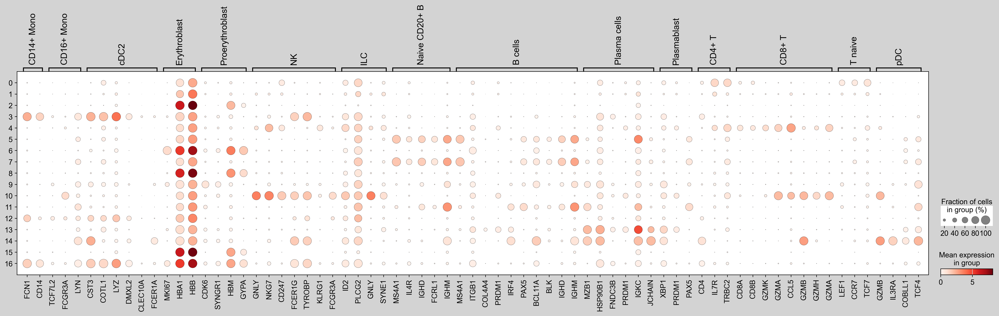

In [71]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden_res0_5');


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res0_5']`


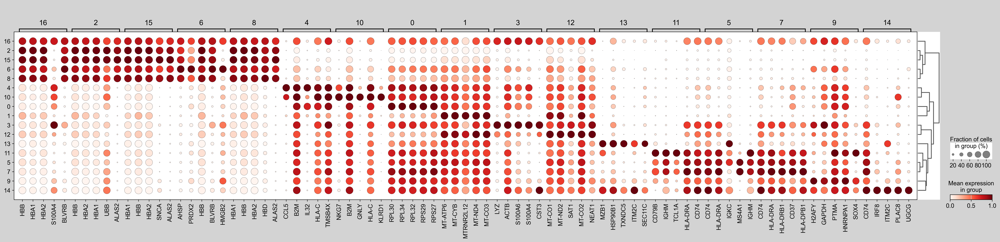

In [66]:
sc.pl.rank_genes_groups_dotplot(adata, groupby="leiden_res0_5", standard_scale="var", n_genes=5, show =True)

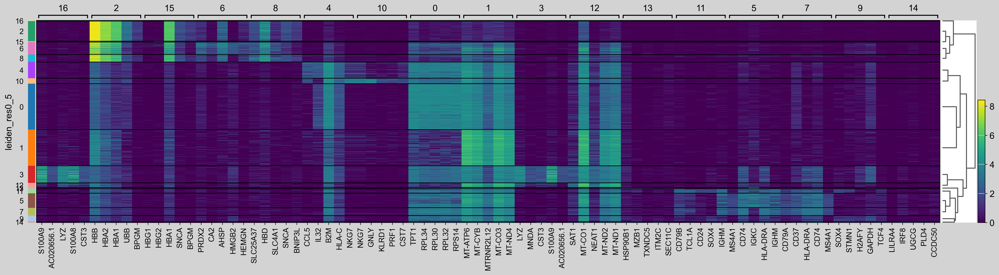

In [92]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", show_gene_labels=True, save= "RGGHeatmpa.pdf")

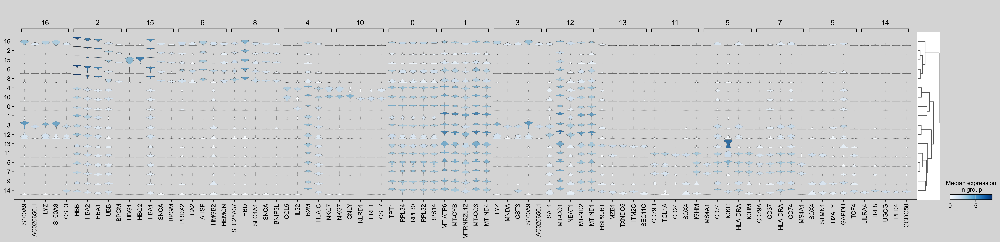

In [124]:
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=5, key="wilcoxon", groupby="leiden_res0_5")

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

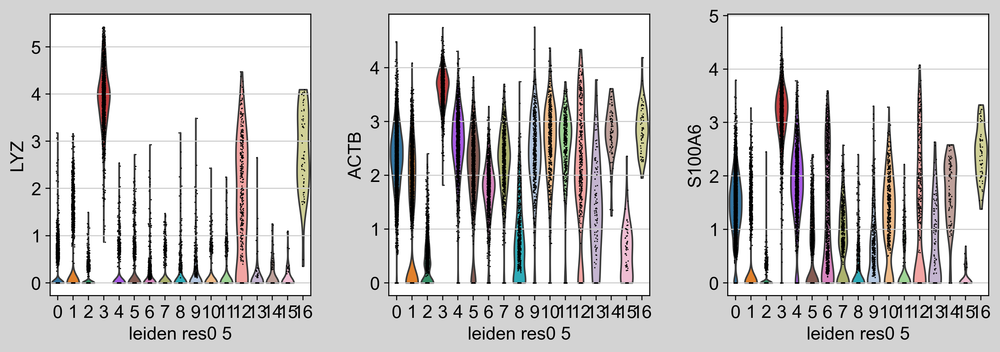

In [88]:
sc.pl.violin(adata, keys=cluster3_genes[0:3], groupby="leiden_res0_5", multi_panel=True)

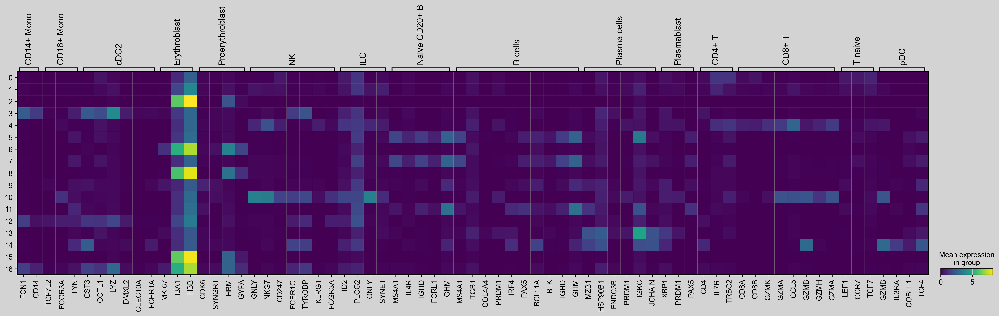

In [119]:
sc.pl.matrixplot(adata, marker_genes, groupby='leiden_res0_5', use_raw=False, save="wilcoxon")


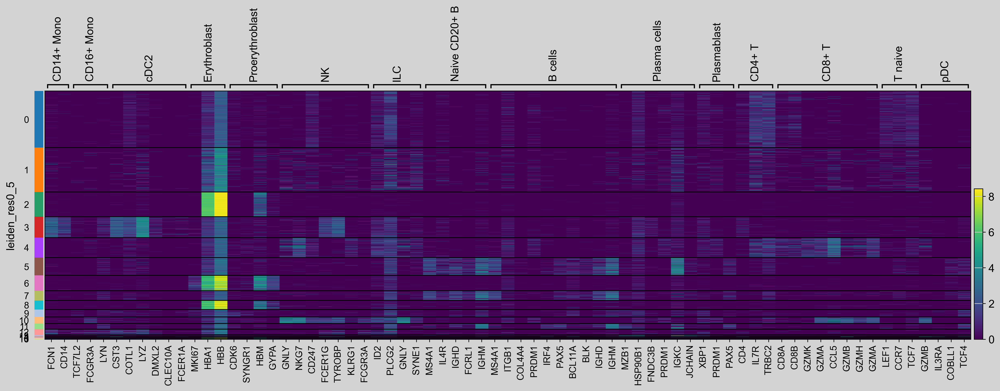

In [96]:
sc.pl.heatmap(adata, marker_genes,  groupby="leiden_res0_5", show_gene_labels=True, save="normal_heatmap.pdf")

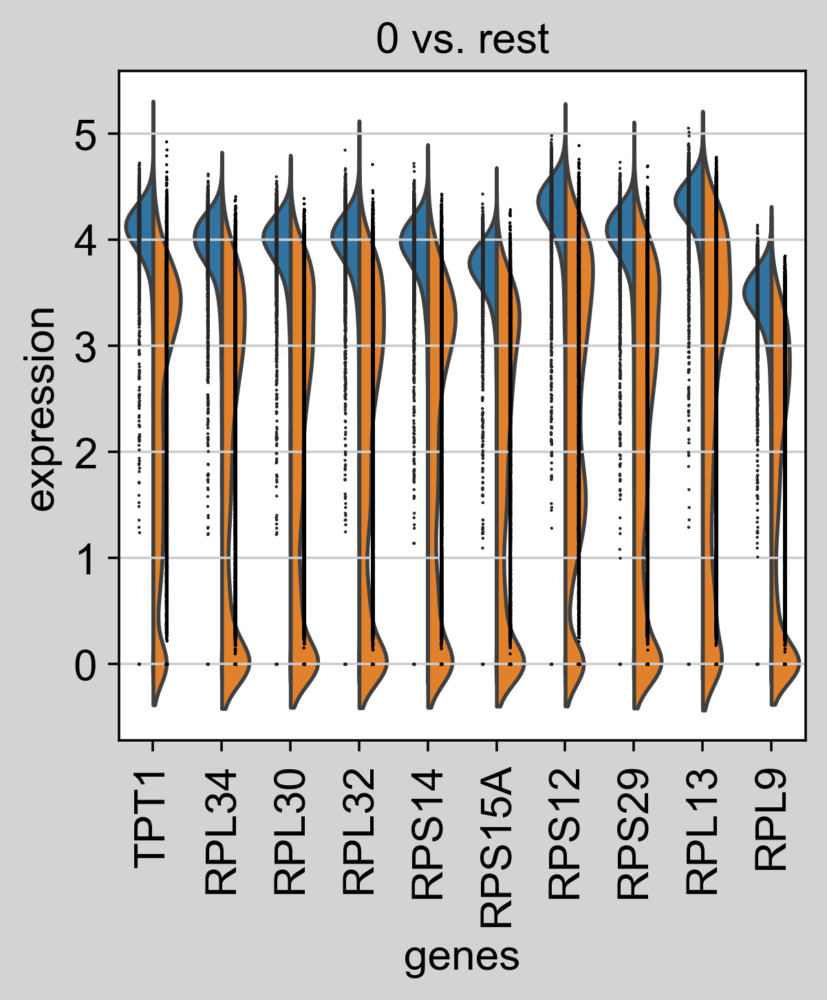

In [140]:
sc.pl.rank_genes_groups_violin(adata, groups='0', n_genes=10, jitter= 0.01, split= True, strip= True, key="wilcoxon" )


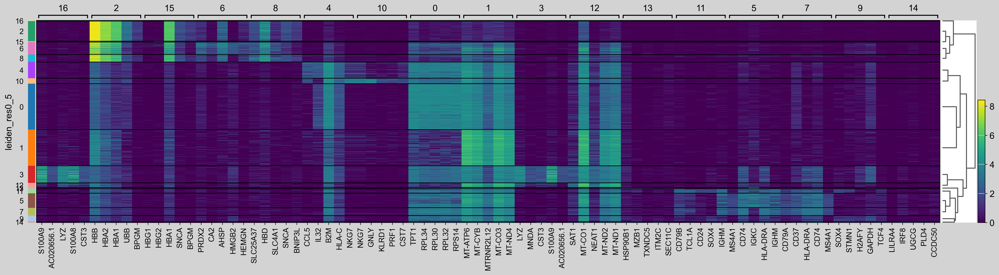

In [133]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", show_gene_labels=True)

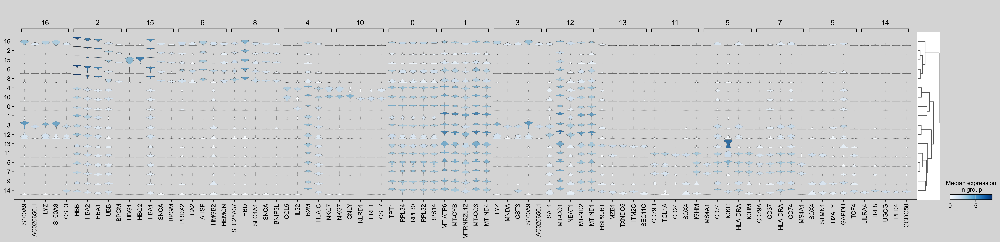

In [132]:
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", save="RGGStackedViolin£.pdf")

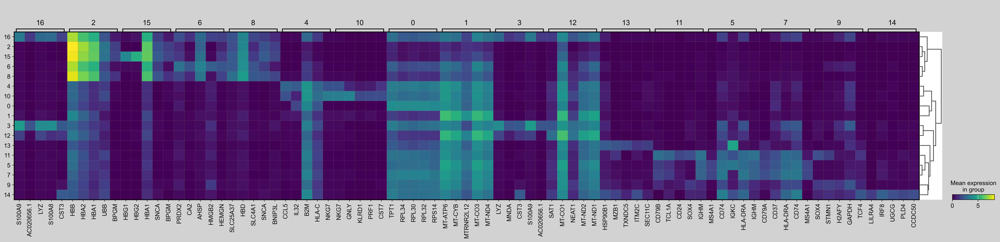

In [98]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", save="RGGmatrix.pdf")

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

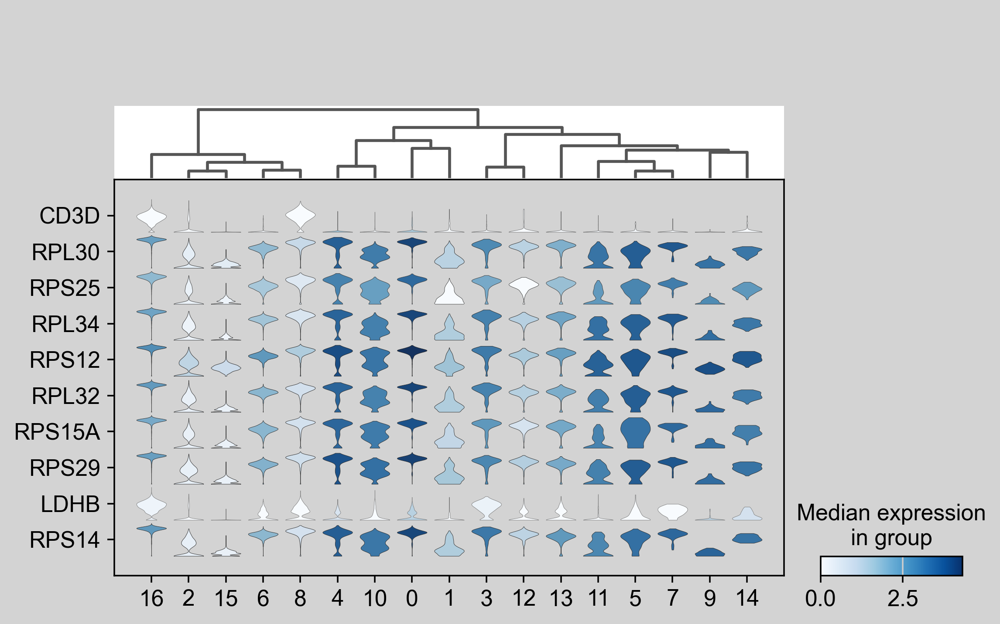

In [125]:
# plot the same genes as violins across all the datasets.

# convert numpy.recarray to list
mynames = [x[0] for x in adata.uns['rank_genes_groups']['names'][:10]]
sc.pl.stacked_violin(adata, mynames, groupby = 'leiden_res0_5',save="stackedviolin.pdf",swap_axes=True, dendrogram=True
)

ranking genes
    finished (0:00:07)


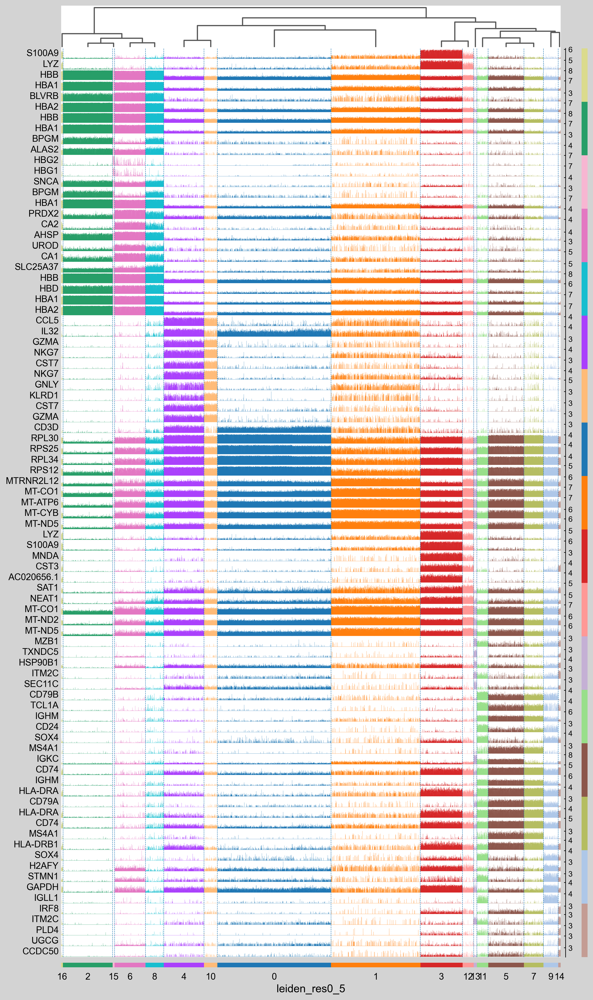

In [128]:
sc.tl.rank_genes_groups(adata, groupby='leiden_res0_5',method='t-test_overestim_var', n_genes=10) # compute differential expression
sc.pl.rank_genes_groups_tracksplot(adata,  groupby='leiden_res0_5',n_genes=5, keys=cluster3_genes[0:3], save="tracks_plot.pdf") # plot the result